# **Network Stock Portfolio Optimization**

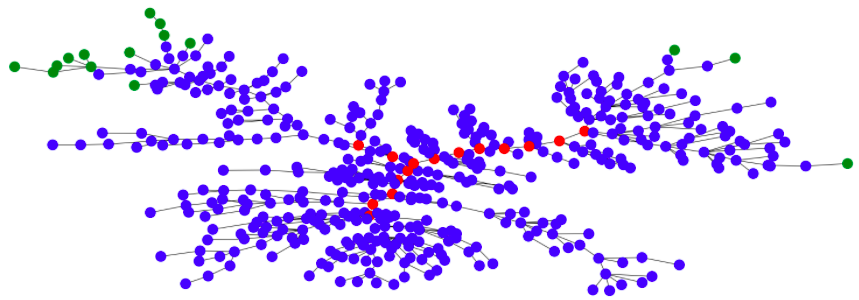

## **Context and Problem Statement**

Active investing in the asset management industry **aims to beat the stock market’s average returns**, for which portfolio managers track a particular index and try to beat that index by creating their own portfolios. 

Portfolio construction involves selection of stocks that have a **higher probability of giving better returns** in comparison to the tracking index, like **S&P 500**. In this project, we will use the concept of Network Analysis to select a basket of stocks and create two portfolios. We will then simulate portfolio value by investing a certain amount, keeping the portfolio for an entire year and we will then compare it against the S&P 500 index. 

In this project we will try to follow the approach mentioned in the below research paper: 

**[Dynamic portfolio strategy using a clustering
approach](https://arxiv.org/pdf/1608.03058.pdf)**

## **Proposed Approach**

- Collect the price data for all S&P 500 components from 2011 till 2020
- Compute log returns for the S&P 500 components for same time period
- Compute the **correlation matrix** for the above log returns
- Find out the **Top n central and peripheral stocks** based on the following network topological parameters:
    - Degree centrality
    - Betweenness centrality
    - Distance on degree criterion
    - Distance on correlation criterion
    - Distance on distance criterion
- Simulate the performance of central and peripheral portfolios against the performance of S&P 500 for the year 2021    

# (1) Collect the price data for all S&P 500 components from 2011 till 2020

## **Loading the Libraries**

We will need to first install the library - `pandas_datareader` using `%conda install pandas-datareader`

> new packages: <br>
> conda install -c conda-forge tqdm <br>
> conda install plotly 

In [1]:
import tqdm
import requests
import numpy as np
import pandas as pd
import seaborn as sns
import networkx as nx
import plotly.express as px
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
import pandas_datareader as webreader
import pandas_datareader.data as web
import yfinance as yf

import warnings
# warnings.filterwarnings('ignore')

## **Getting the S&P 500 Components**

Beautiful Soup is a library that makes it easy to scrape information from web pages.

https://www.crummy.com/software/BeautifulSoup/bs4/doc/

In [2]:
from IPython.display import IFrame
url = "http://en.wikipedia.org/wiki/List_of_S%26P_500_companies"
IFrame(src=url, width=700, height=350)

In [3]:
#Extracting list of S&P 500 companies using BeautifulSoup.
resp = requests.get('http://en.wikipedia.org/wiki/List_of_S%26P_500_companies')

# lxml is the most feature-rich and easy-to-use library for processing XML and HTML 
# in the Python language.
soup = BeautifulSoup(resp.text, 'lxml') 

table = soup.find('table', {'class': 'wikitable sortable'})
tickers = []
for row in table.findAll('tr')[1:]:
    ticker = row.findAll('td')[0].text.strip('\n')
    tickers.append(ticker)
    
tickers = [ticker.replace('.', '-') for ticker in tickers] # list of S&P 500 stocks
print(tickers)

['MMM', 'AOS', 'ABT', 'ABBV', 'ACN', 'ATVI', 'ADM', 'ADBE', 'ADP', 'AAP', 'AES', 'AFL', 'A', 'APD', 'AKAM', 'ALK', 'ALB', 'ARE', 'ALGN', 'ALLE', 'LNT', 'ALL', 'GOOGL', 'GOOG', 'MO', 'AMZN', 'AMCR', 'AMD', 'AEE', 'AAL', 'AEP', 'AXP', 'AIG', 'AMT', 'AWK', 'AMP', 'ABC', 'AME', 'AMGN', 'APH', 'ADI', 'ANSS', 'AON', 'APA', 'AAPL', 'AMAT', 'APTV', 'ACGL', 'ANET', 'AJG', 'AIZ', 'T', 'ATO', 'ADSK', 'AZO', 'AVB', 'AVY', 'AXON', 'BKR', 'BALL', 'BAC', 'BBWI', 'BAX', 'BDX', 'WRB', 'BRK-B', 'BBY', 'BIO', 'TECH', 'BIIB', 'BLK', 'BK', 'BA', 'BKNG', 'BWA', 'BXP', 'BSX', 'BMY', 'AVGO', 'BR', 'BRO', 'BF-B', 'BG', 'CHRW', 'CDNS', 'CZR', 'CPT', 'CPB', 'COF', 'CAH', 'KMX', 'CCL', 'CARR', 'CTLT', 'CAT', 'CBOE', 'CBRE', 'CDW', 'CE', 'CNC', 'CNP', 'CDAY', 'CF', 'CRL', 'SCHW', 'CHTR', 'CVX', 'CMG', 'CB', 'CHD', 'CI', 'CINF', 'CTAS', 'CSCO', 'C', 'CFG', 'CLX', 'CME', 'CMS', 'KO', 'CTSH', 'CL', 'CMCSA', 'CMA', 'CAG', 'COP', 'ED', 'STZ', 'CEG', 'COO', 'CPRT', 'GLW', 'CTVA', 'CSGP', 'COST', 'CTRA', 'CCI', 'CSX', 'C

## **Getting the Price Data for all the S&P 500 components in the last 10 years**

In [4]:
# We will get the dataset for yahoo
# Not working --> known issue for the new delivered yahoo api:
# typeerror: string indices must be integer pandas datareader

# price_data = web.DataReader(tickers, 'yahoo', start='2011-01-01', end='2020-12-31')  
# price_data = price_data['Adj Close']    # we will get all the data points and we also get the 
#                                         # volume not only the close price, open price
# price_data.to_csv('snp500_price_data_2011_to_2020.csv')

In [5]:
# First solution: Use yfinance
yf.pdr_override() # <== that's all it takes :-)
price_data = web.get_data_yahoo(tickers, start='2011-01-01', end='2020-12-31')
price_data = price_data['Adj Close'] 
price_data.head()

[*********************100%***********************]  503 of 503 completed

ERROR 
3 Failed downloads:
ERROR ['GEHC']: Exception("GEHC: Data doesn't exist for startDate = 1293858000, endDate = 1609390800")
ERROR ['OGN']: Exception("OGN: Data doesn't exist for startDate = 1293858000, endDate = 1609390800")
ERROR ['CEG']: Exception("CEG: Data doesn't exist for startDate = 1293858000, endDate = 1609390800")


,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACGL,ACN,ADBE,...,WYNN,XEL,XOM,XRAY,XYL,YUM,ZBH,ZBRA,ZION,ZTS
Date,,,,,,,,,,,,,,,,,,,,,
2011-01-03 00:00:00,27.119429,10.040196,59.804134,10.004128,NaN,28.380127,17.551394,9.832222,38.487572,31.290001,...,77.456818,15.662282,45.750076,32.108036,NaN,27.773907,48.534832,38.200001,20.526564,NaN
2011-01-04 00:00:00,26.866879,10.011915,56.827610,10.056339,NaN,28.065887,17.716557,9.771111,38.234093,31.510000,...,79.873169,15.728764,45.964855,31.751284,NaN,27.349575,47.890274,37.840000,20.192198,NaN
2011-01-05 00:00:00,26.808605,10.464431,56.900654,10.138601,NaN,28.495901,17.716557,9.785556,38.242027,32.220001,...,80.903625,15.635695,45.842117,32.053169,NaN,27.479713,47.925610,37.799999,20.306364,NaN
2011-01-06 00:00:00,26.860409,10.596413,55.028915,10.130406,NaN,28.826664,17.679846,9.653333,38.384590,32.270000,...,81.493484,15.622395,46.136700,31.870211,NaN,27.672071,46.442276,37.480000,20.249285,NaN
2011-01-07 00:00:00,26.951063,10.747252,56.498920,10.202958,NaN,28.884554,17.753258,9.580000,38.447956,32.040001,...,84.378838,15.762000,46.388294,31.742147,NaN,28.017193,46.433441,37.599998,20.037247,NaN


In [6]:
# Second solution: Use a different remote data access instead of yahoo (Not having same columns)
# More Remote Data Access: https://pandas-datareader.readthedocs.io/en/latest/remote_data.html

# import pandas_datareader as webreader
# # Send the request to the yahoo finance api endpoint
# df = webreader.DataReader(tickers, start='2011-01-01', end='2020-12-31', data_source='stooq')
# df.head(5)

## **Reading the Price Data for all the S&P 500 components in the last 10 years**

In [7]:
price_data = pd.read_csv('data/snp500_price_data_2011_to_2020.csv', index_col=[0])

In [8]:
price_data.head()

,MMM,AOS,ABT,ABBV,ABMD,ACN,ATVI,ADM,ADBE,ADP,...,XEL,XLNX,XYL,YUM,ZBRA,ZBH,ZION,ZTS,CEG,OGN
Date,,,,,,,,,,,,,,,,,,,,,
2010-12-31,63.855606,8.113162,17.986767,NaN,9.61,39.143620,11.245819,22.385578,30.780001,31.271172,...,16.221039,23.216919,NaN,28.547478,37.990002,49.212429,21.089169,NaN,NaN,NaN
2011-01-03,64.218163,8.125947,17.952976,NaN,9.80,39.224346,11.318138,22.623722,31.290001,31.791464,...,16.227924,23.569420,NaN,28.570745,38.200001,50.395058,21.907326,NaN,NaN,NaN
2011-01-04,64.129395,8.100383,18.121916,NaN,9.80,38.966022,11.327178,22.608845,31.510000,31.676586,...,16.296804,23.665552,NaN,28.134232,37.840000,49.725819,21.550467,NaN,NaN,NaN
2011-01-05,64.129395,8.285738,18.121916,NaN,10.03,38.974094,11.110217,22.713020,32.220001,32.183357,...,16.200367,23.745670,NaN,28.268110,37.799999,49.762482,21.672325,NaN,NaN,NaN
2011-01-06,63.737186,8.289999,18.084377,NaN,10.05,39.119389,11.083097,23.583750,32.270000,32.433369,...,16.186602,24.146229,NaN,28.465996,37.480000,48.222305,21.611391,NaN,NaN,NaN


## **Missing Data due to Index Rebalancing**

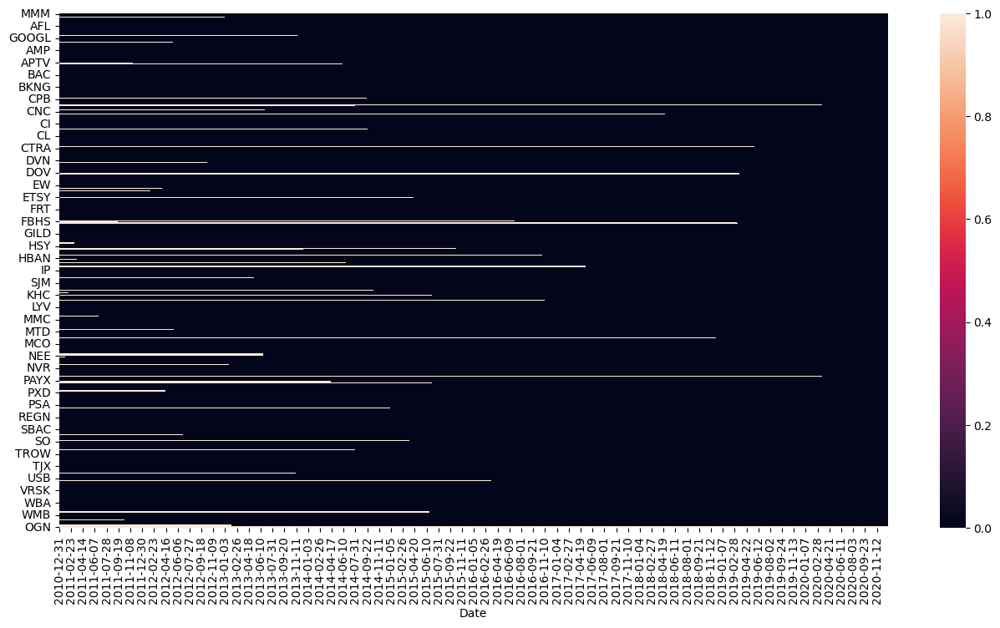

In [9]:
figure = plt.figure(figsize=(16, 8))
sns.heatmap(price_data.T.isnull());

In [10]:
price_data.shape

(2518, 505)

The missing data is due to the fact that **certain stocks may move out of the S&P 500** and **certain stocks may enter the S&P 500** in this respective timeframe.

In [11]:
price_data_cleaned = price_data.dropna(axis=1) # dropping na values columnwise
price_data_cleaned.shape

(2518, 450)

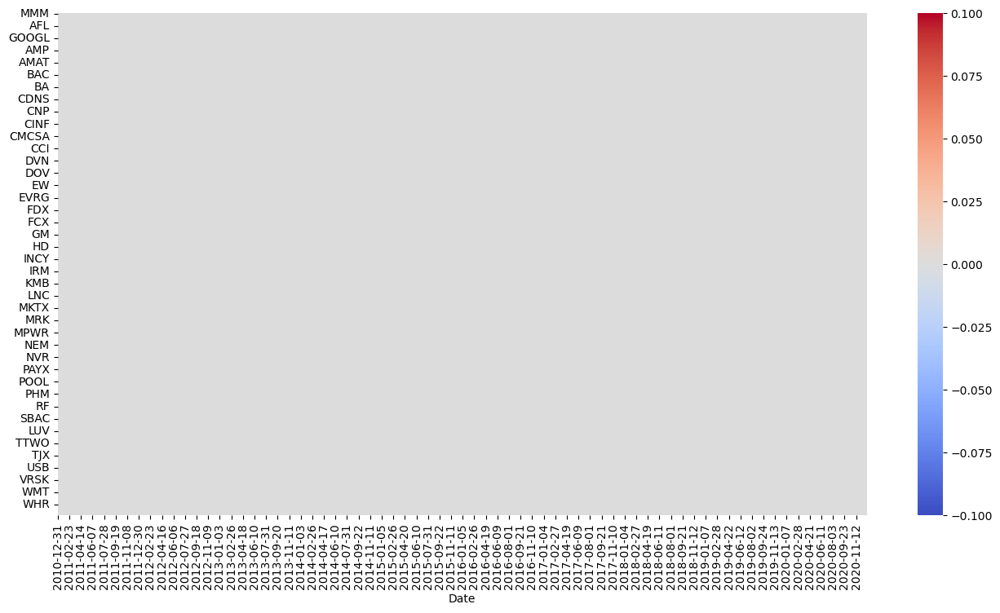

In [12]:
figure = plt.figure(figsize=(16, 8))
sns.heatmap(price_data_cleaned.T.isnull(), cmap='coolwarm');

The null values are removed - the data is clean and the plot also helps in finding that there are no missing values.

In [13]:
price_data_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2518 entries, 2010-12-31 to 2020-12-31
Columns: 450 entries, MMM to ZION
dtypes: float64(450)
memory usage: 8.7+ MB


In [14]:
price_data_cleaned.index.dtype

dtype('O')

## **Getting Yearwise Data**

In [15]:
def get_year_wise_snp_500_data(data, year):
    year_wise_data = data.loc['{}-01-01'.format(year):'{}-12-31'.format(year)]
    
    return year_wise_data

In [16]:
# Getting year wise data of S&P stocks from 2011 to 2020
snp_500_2011 = get_year_wise_snp_500_data(price_data_cleaned, 2011)
snp_500_2012 = get_year_wise_snp_500_data(price_data_cleaned, 2012)
snp_500_2013 = get_year_wise_snp_500_data(price_data_cleaned, 2013)
snp_500_2014 = get_year_wise_snp_500_data(price_data_cleaned, 2014)
snp_500_2015 = get_year_wise_snp_500_data(price_data_cleaned, 2015)
snp_500_2016 = get_year_wise_snp_500_data(price_data_cleaned, 2016)
snp_500_2017 = get_year_wise_snp_500_data(price_data_cleaned, 2017)
snp_500_2018 = get_year_wise_snp_500_data(price_data_cleaned, 2018)
snp_500_2019 = get_year_wise_snp_500_data(price_data_cleaned, 2019)
snp_500_2020 = get_year_wise_snp_500_data(price_data_cleaned, 2020)

In [17]:
snp_500_2011.head()

,MMM,AOS,ABT,ABMD,ACN,ATVI,ADM,ADBE,ADP,AAP,...,WHR,WMB,WTW,WYNN,XEL,XLNX,YUM,ZBRA,ZBH,ZION
Date,,,,,,,,,,,,,,,,,,,,,
2011-01-03,64.218163,8.125947,17.952976,9.80,39.224346,11.318138,22.623722,31.290001,31.791464,62.732765,...,67.926483,11.205445,93.139076,77.632828,16.227924,23.569420,28.570745,38.200001,50.395058,21.907326
2011-01-04,64.129395,8.100383,18.121916,9.80,38.966022,11.327178,22.608845,31.510000,31.676586,59.610516,...,66.950417,11.123855,91.576157,80.054619,16.296804,23.665552,28.134232,37.840000,49.725819,21.550467
2011-01-05,64.129395,8.285738,18.121916,10.03,38.974094,11.110217,22.713020,32.220001,32.183357,59.687115,...,67.400887,11.141987,92.847679,81.087433,16.200367,23.745670,28.268110,37.799999,49.762482,21.672325
2011-01-06,63.737186,8.289999,18.084377,10.05,39.119389,11.083097,23.583750,32.270000,32.433369,57.723724,...,65.966843,11.119320,93.112579,81.678650,16.186602,24.146229,28.465996,37.480000,48.222305,21.611391
2011-01-07,63.803787,8.409311,18.159452,9.89,39.183979,10.938456,23.777237,32.040001,32.507687,59.265705,...,65.689018,11.296103,92.953644,84.570557,16.331245,24.010040,28.821018,37.599998,48.213131,21.385098


In [18]:
snp_500_2011.shift(1).head()

,MMM,AOS,ABT,ABMD,ACN,ATVI,ADM,ADBE,ADP,AAP,...,WHR,WMB,WTW,WYNN,XEL,XLNX,YUM,ZBRA,ZBH,ZION
Date,,,,,,,,,,,,,,,,,,,,,
2011-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2011-01-04,64.218163,8.125947,17.952976,9.80,39.224346,11.318138,22.623722,31.290001,31.791464,62.732765,...,67.926483,11.205445,93.139076,77.632828,16.227924,23.569420,28.570745,38.200001,50.395058,21.907326
2011-01-05,64.129395,8.100383,18.121916,9.80,38.966022,11.327178,22.608845,31.510000,31.676586,59.610516,...,66.950417,11.123855,91.576157,80.054619,16.296804,23.665552,28.134232,37.840000,49.725819,21.550467
2011-01-06,64.129395,8.285738,18.121916,10.03,38.974094,11.110217,22.713020,32.220001,32.183357,59.687115,...,67.400887,11.141987,92.847679,81.087433,16.200367,23.745670,28.268110,37.799999,49.762482,21.672325
2011-01-07,63.737186,8.289999,18.084377,10.05,39.119389,11.083097,23.583750,32.270000,32.433369,57.723724,...,65.966843,11.119320,93.112579,81.678650,16.186602,24.146229,28.465996,37.480000,48.222305,21.611391


# (2) Compute log returns for the S&P 500 components for same time period

## **Computing the Daily Log Returns**

Statistically, **simple stock returns are always assumed to follow a Log Normal distribution**. It is therefore plausible to use properties of the Normal distribution in statistical estimation for Log returns, but not for the simple returns.

Stock Returns analysis is a time series analysis, in which you also take care of stationarity which is normally obtained from Log returns but not from simple returns.

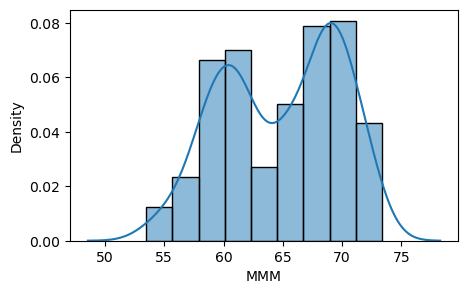

In [19]:
# sns.histplot(snp_500_2011.MMM)
plt.figure(figsize = (5, 3))
sns.histplot(snp_500_2011.MMM, kde=True, stat="density", kde_kws=dict(cut=3))
plt.show()

In [20]:
# Calculating daily log returns by subtracting between two days with the help of shift function
log_returns_2011 = np.log(snp_500_2011.shift(1)) - np.log(snp_500_2011)
log_returns_2012 = np.log(snp_500_2012.shift(1)) - np.log(snp_500_2012)
log_returns_2013 = np.log(snp_500_2013.shift(1)) - np.log(snp_500_2013)
log_returns_2014 = np.log(snp_500_2014.shift(1)) - np.log(snp_500_2014)
log_returns_2015 = np.log(snp_500_2015.shift(1)) - np.log(snp_500_2015)
log_returns_2016 = np.log(snp_500_2016.shift(1)) - np.log(snp_500_2016)
log_returns_2017 = np.log(snp_500_2017.shift(1)) - np.log(snp_500_2017)
log_returns_2018 = np.log(snp_500_2018.shift(1)) - np.log(snp_500_2018)
log_returns_2019 = np.log(snp_500_2019.shift(1)) - np.log(snp_500_2019)
log_returns_2020 = np.log(snp_500_2020.shift(1)) - np.log(snp_500_2020)

# (3) Compute the correlation matrix for the above log returns

## **Computing the Correlation of Returns**

In [21]:
# Computing adjacency matrix:
return_correlation_2011 = log_returns_2011.corr()
return_correlation_2012 = log_returns_2012.corr()
return_correlation_2013 = log_returns_2013.corr()
return_correlation_2014 = log_returns_2014.corr()
return_correlation_2015 = log_returns_2015.corr()
return_correlation_2016 = log_returns_2016.corr()
return_correlation_2017 = log_returns_2017.corr()
return_correlation_2018 = log_returns_2018.corr()
return_correlation_2019 = log_returns_2019.corr()
return_correlation_2020 = log_returns_2020.corr()

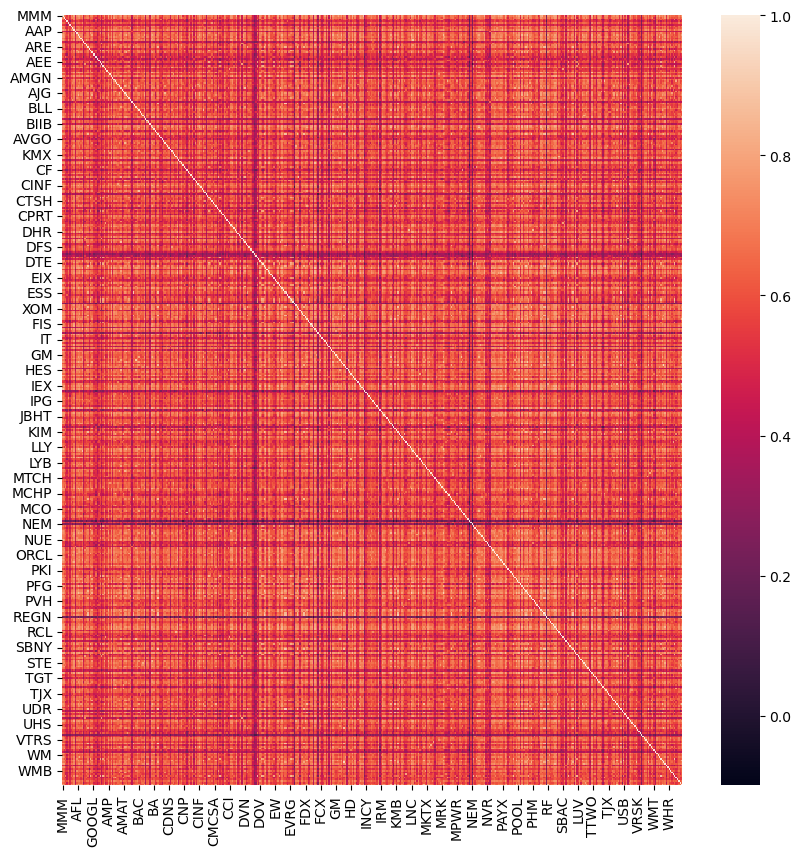

In [22]:
plt.figure(figsize = (10, 10))
sns.heatmap(return_correlation_2011);
plt.show()

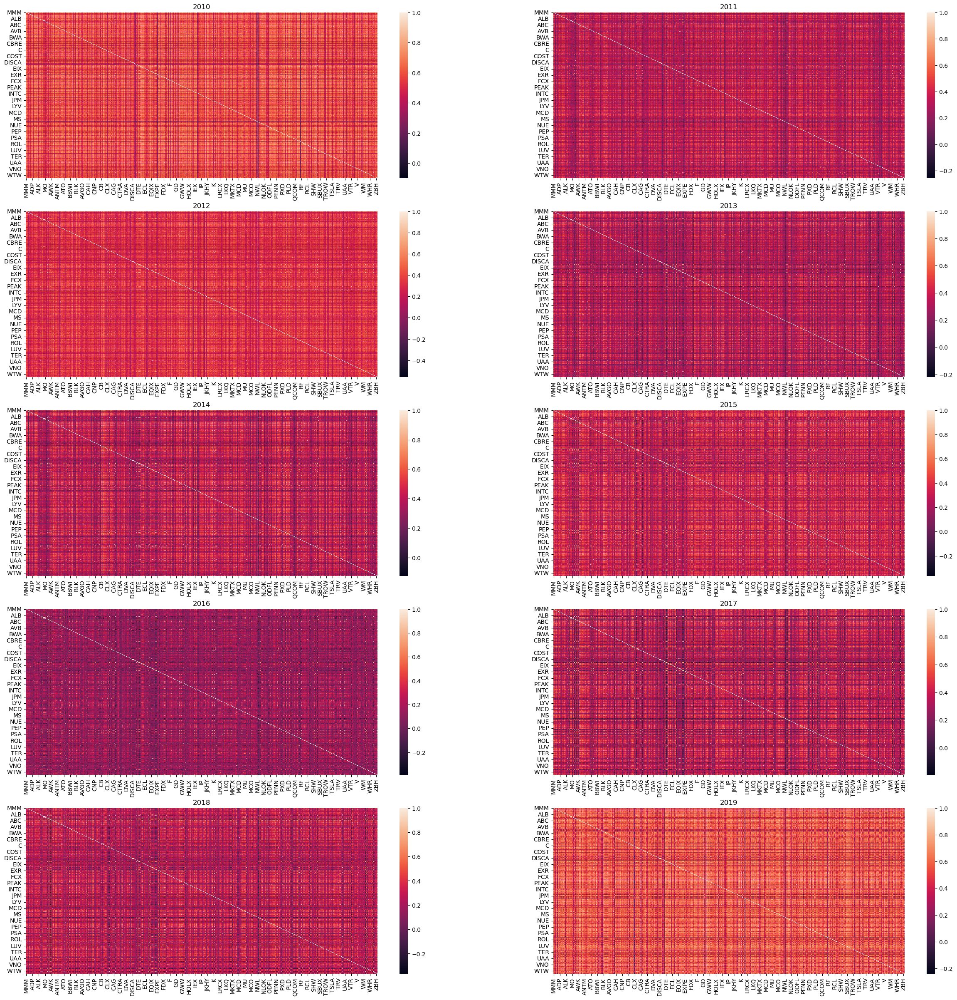

In [23]:
# Organizing the data
data = [
    return_correlation_2011,
    return_correlation_2012,
    return_correlation_2013,
    return_correlation_2014,
    return_correlation_2015,
    return_correlation_2016,
    return_correlation_2017,
    return_correlation_2018,
    return_correlation_2019,
    return_correlation_2020
]

# Plotting
figure, axes = plt.subplots(5, 2, figsize=(30, 30))
axes = axes.ravel()
for i, df in enumerate(data):
    sns.heatmap(df, ax=axes[i])
    axes[i].set_title(f'{2010+i}')
plt.show()

## **Inferences**

The first plot for the year 2011 shows that there is high correlation among the stocks. It shows that since in 2011 there was a market crash and there was volatility in the market, the prices of the stock went down along with the other stocks and this is the reason for high correlation.

Similarly in 2012, 2014 and 2017 the market is kind of stable, and hence the correlation among stocks is low.

In 2020, due to the COVID pandemic and the volatility in the market, the prices of the stock went down or up along with other stocks, and this is the reason for high correlation.

From this we can infer that, **In stable market conditions, correlation matrices have low correlation values whereas in critical market conditions, correlation matrices have high correlation values.**

## **Creating Graphs**

In [24]:
graph_2011 = nx.Graph(return_correlation_2011)

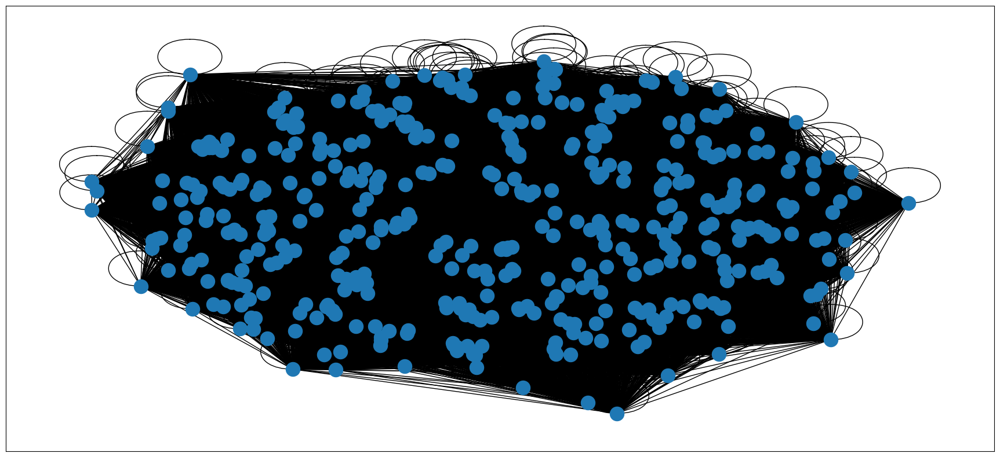

In [25]:
figure = plt.figure(figsize=(22, 10))
nx.draw_networkx(graph_2011, with_labels=False)

This is a **fully connected network** as we created it using the correlation matrix.

A fully connected network means every variable has connections with all the other variables in the network and will also have self-loops.

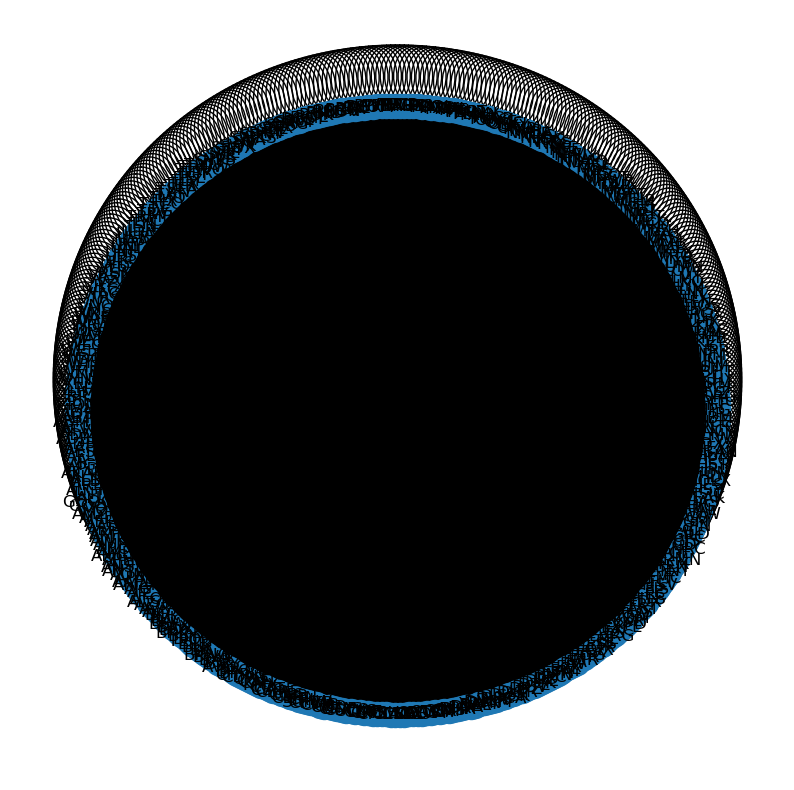

In [26]:
plt.figure(figsize = (10, 10))
ax = plt.subplot(111)
nx.draw_shell(graph_2011, with_labels=True, ax=ax)
plt.show()

## **Filtering Graphs using MST**

**MST - Minimum Spanning Tree**

A minimum spanning tree (MST) or minimum weight spanning tree is a subset of the edges of a connected, edge-weighted undirected graph that connects all the vertices together, without any cycles and with the minimum possible total edge weight.That is, it is a spanning tree whose sum of edge weights is as small as possible.

**MST** is one of the popular techniques to eliminate the redundancies and noise and meanwhile maintain the significant links in the network.

While removing redundancy and noise in the data using MST, we might lose some information as well.

You can find more on MST [here](https://visualgo.net/en/mst)

In [27]:
distance_2011 = np.sqrt(2 * (1 - return_correlation_2011))
distance_2012 = np.sqrt(2 * (1 - return_correlation_2012))
distance_2013 = np.sqrt(2 * (1 - return_correlation_2013))
distance_2014 = np.sqrt(2 * (1 - return_correlation_2014))
distance_2015 = np.sqrt(2 * (1 - return_correlation_2015))
distance_2016 = np.sqrt(2 * (1 - return_correlation_2016))
distance_2017 = np.sqrt(2 * (1 - return_correlation_2017))
distance_2018 = np.sqrt(2 * (1 - return_correlation_2018))
distance_2019 = np.sqrt(2 * (1 - return_correlation_2019))
distance_2020 = np.sqrt(2 * (1 - return_correlation_2020))

Before the construction of the MST graph, **the correlation coefficient is converted into a distance.**

In [28]:
distance_2011_graph = nx.Graph(distance_2011)
distance_2012_graph = nx.Graph(distance_2012)
distance_2013_graph = nx.Graph(distance_2013)
distance_2014_graph = nx.Graph(distance_2014)
distance_2015_graph = nx.Graph(distance_2015)
distance_2016_graph = nx.Graph(distance_2016)
distance_2017_graph = nx.Graph(distance_2017)
distance_2018_graph = nx.Graph(distance_2018)
distance_2019_graph = nx.Graph(distance_2019)
distance_2020_graph = nx.Graph(distance_2020)

In [29]:
graph_2011_filtered = nx.minimum_spanning_tree(distance_2011_graph)
graph_2012_filtered = nx.minimum_spanning_tree(distance_2012_graph)
graph_2013_filtered = nx.minimum_spanning_tree(distance_2013_graph)
graph_2014_filtered = nx.minimum_spanning_tree(distance_2014_graph)
graph_2015_filtered = nx.minimum_spanning_tree(distance_2015_graph)
graph_2016_filtered = nx.minimum_spanning_tree(distance_2016_graph)
graph_2017_filtered = nx.minimum_spanning_tree(distance_2017_graph)
graph_2018_filtered = nx.minimum_spanning_tree(distance_2018_graph)
graph_2019_filtered = nx.minimum_spanning_tree(distance_2019_graph)
graph_2020_filtered = nx.minimum_spanning_tree(distance_2020_graph)

We choose the MST method to filter out the network graph in each window so as to eliminate the redundancies and noise, and still maintain significant links.

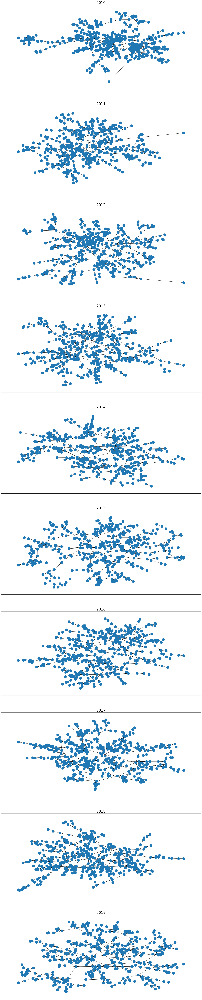

In [30]:
# Organizing the data
data = [ graph_2011_filtered, graph_2012_filtered, graph_2013_filtered, 
         graph_2014_filtered, graph_2015_filtered, graph_2016_filtered, 
         graph_2017_filtered, graph_2018_filtered, graph_2019_filtered, 
         graph_2020_filtered ]

# Plotting
figure, axes = plt.subplots(10, 1, figsize=(24, 120))
axes = axes.ravel()
for i, df in enumerate(data):
    nx.draw_networkx(df, with_labels=False, ax=axes[i])
    axes[i].set_title(f'{2010+i}', fontsize=24)
plt.show()

On plotting the graphs, we see that the network looks different every year, and no two yearwise graphs look very similar.

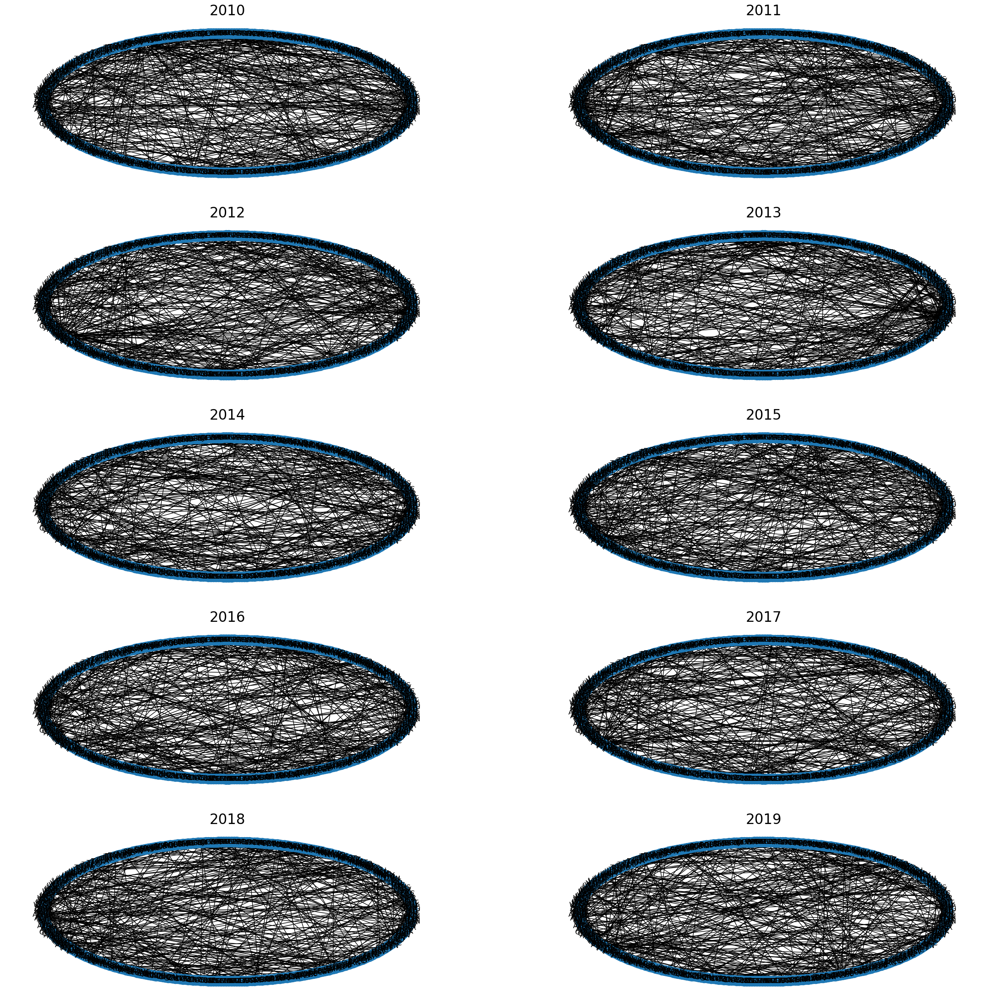

In [31]:
# Organizing the data
data = [ graph_2011_filtered, graph_2012_filtered, graph_2013_filtered, 
         graph_2014_filtered, graph_2015_filtered, graph_2016_filtered, 
         graph_2017_filtered, graph_2018_filtered, graph_2019_filtered, 
         graph_2020_filtered ]

# Plotting
figure, axes = plt.subplots(5, 2, figsize=(30, 30))
axes = axes.ravel()
for i, df in enumerate(data):
    nx.draw_shell(df, with_labels=True, ax=axes[i])
    axes[i].set_title(f'{2010+i}', fontsize=24)
plt.show()

# (4) Find out the Top n central and peripheral stocks based on the following network topological parameters:

- Degree centrality
- Betweenness centrality
- Distance on degree criterion
- Distance on correlation criterion
- Distance on distance criterion

## **Computing Graph Statistics over Time**

In [32]:
average_degree_connectivity = {}
average_shortest_path_length = {}
year = [2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020]

for y, graph in enumerate([graph_2011_filtered, graph_2012_filtered, graph_2013_filtered, 
                           graph_2014_filtered, graph_2015_filtered, graph_2016_filtered, 
                           graph_2017_filtered, graph_2018_filtered, graph_2019_filtered, 
                           graph_2020_filtered]):
    average_shortest_path_length[year[y]] = nx.average_shortest_path_length(graph)
    average_degree_connectivity[year[y]] = nx.average_degree_connectivity(graph)

In [33]:
average_shortest_path_length

{2011: 7.880069289779757,
 2012: 8.934273694630042,
 2013: 7.978500371195249,
 2014: 9.327324919574362,
 2015: 9.045444196980945,
 2016: 11.861855976243504,
 2017: 18.625290769611482,
 2018: 14.434872556297947,
 2019: 11.634239049740163,
 2020: 15.003860430586489}

In [34]:
# The average degree connectivity is the average nearest neighbor degree of nodes with degree k.
print(f"""
The average degree for year 2011 is:
{average_degree_connectivity[2011]}

'MMM' as node in graph_2011_filtered has degree: {graph_2011_filtered.degree['MMM']}

Degrees found in graph_2011_filtered are:
{average_degree_connectivity[2011].keys()}
""")


The average degree for year 2011 is:
{2: 5.362385321100917, 1: 7.574712643678161, 10: 3.7, 3: 3.8684210526315788, 4: 4.4772727272727275, 7: 4.595238095238095, 5: 4.525, 11: 2.590909090909091, 6: 4.142857142857143, 8: 4.5, 19: 4.894736842105263, 42: 2.8333333333333335}

'MMM' as node in graph_2011_filtered has degree: 2

Degrees found in graph_2011_filtered are:
dict_keys([2, 1, 10, 3, 4, 7, 5, 11, 6, 8, 19, 42])



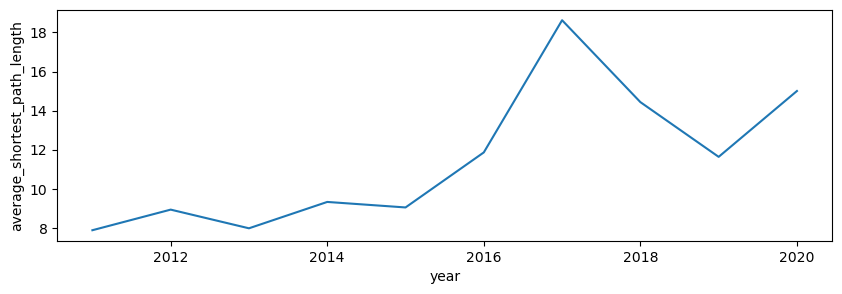

In [35]:
figure = plt.figure(figsize=(10, 3))
sns.lineplot(x='year', y='average_shortest_path_length', 
             data=pd.DataFrame({
                 'year': average_shortest_path_length.keys(), 
                 'average_shortest_path_length': average_shortest_path_length.values()
             }));

From the above plot we can see that the shortest path length was more stable till 2015 but there was significant increment in 2016 and 2017 and again there was a decrement in 2018. In 2020 there an increment again. May be this has some correlation with the financial queries. 

## **Portfolio Construction**

Taking again steps 2 and 3:

- (2) Compute log returns for the S&P 500 components for same time period
- (3) Compute the correlation matrix for the above log returns
    - Convert the correlation coefficient into distance.
    - Construct the MST graph.

In [36]:
# (2) Compute log returns for the S&P 500 components for same time period
log_returns_2011_till_2020 = np.log(price_data_cleaned.shift(1)) - np.log(price_data_cleaned)

# (3) Compute the correlation matrix for the above log returns
return_correlation_2011_till_2020 = log_returns_2011_till_2020.corr()

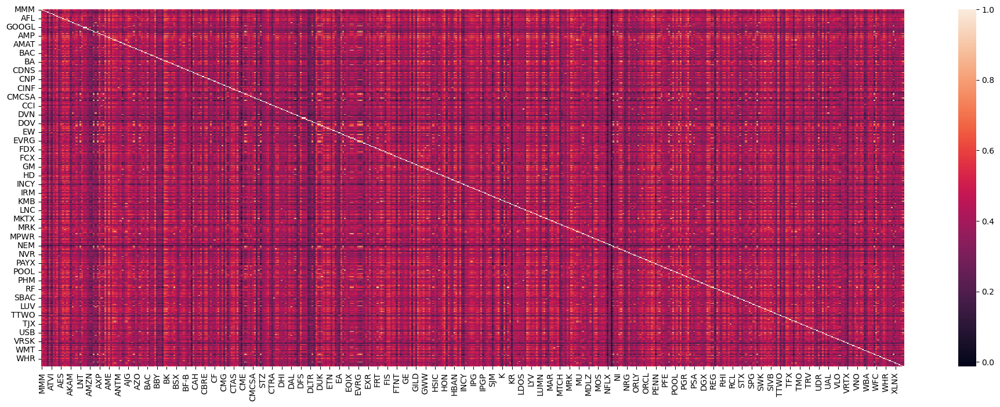

In [37]:
figure = plt.figure(figsize=(24, 8))
sns.heatmap(return_correlation_2011_till_2020);

Once  we have the correlation matrix we need:

- Transform the correlation coefficient into distance by applying the equation:
$$ d = \sqrt{2 \times (1 - r)} $$
- Build the MST graph.

We choose the MST method to filter out the network graph in each window so as to eliminate the redundancies and noise, and still maintain significant links.

In [38]:
# Transforming the correlation coefficient into distance
distance_2011_till_2020 = np.sqrt(2 * (1 - return_correlation_2011_till_2020))

# Building the MST graph
distance_2011_till_2020_graph = nx.Graph(distance_2011_till_2020)
distance_2011_till_2020_graph_filtered = nx.minimum_spanning_tree(distance_2011_till_2020_graph)

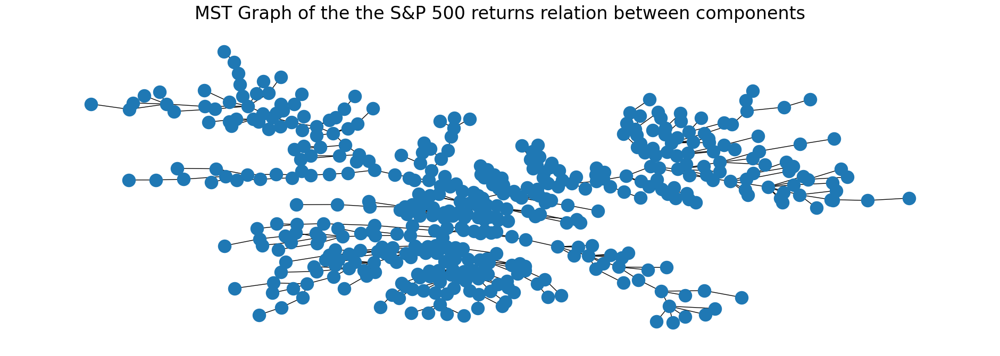

In [39]:
# Kamada-Kawai layaout is a base path-length with low cost-function
figure = plt.figure(figsize=(24, 8))
ax = plt.subplot(111)
nx.draw_kamada_kawai(distance_2011_till_2020_graph_filtered, with_labels=False, ax=ax)
plt.title('MST Graph of the the S&P 500 returns relation between components', fontsize=24)
plt.show()

In [40]:
# (4) Step 4: Find out the Top n central and peripheral stocks based on:
#       - Degree centrality
#       - Betweenness centrality
#       - Distance on degree criterion
#       - Distance on correlation criterion
#       - Distance on distance criterion
degree_centrality = nx.degree_centrality(distance_2011_till_2020_graph_filtered)
closeness_centrality = nx.closeness_centrality(distance_2011_till_2020_graph_filtered)
betweenness_centrality = nx.betweenness_centrality(distance_2011_till_2020_graph_filtered)
eigenvector_centrality=nx.eigenvector_centrality_numpy(distance_2011_till_2020_graph_filtered)

In [41]:
# Same keys items and order cross the four dictionaries
assert degree_centrality.keys() == closeness_centrality.keys()
assert degree_centrality.keys() == betweenness_centrality.keys()
assert degree_centrality.keys() == eigenvector_centrality.keys()

In [42]:
# Let's save the measure in a dataframe
cc_measures_df = pd.DataFrame(data={'degree_centrality': degree_centrality.values(),
                                    'closeness_centrality': closeness_centrality.values(),
                                    'betweenness_centrality': betweenness_centrality.values(),
                                    'eigenvector_centrality': eigenvector_centrality.values()
                                   }, index=degree_centrality.keys())
cc_measures_df.head()

,degree_centrality,closeness_centrality,betweenness_centrality,eigenvector_centrality
MMM,0.002227,0.089531,0.000000,6.482982e-02
AOS,0.004454,0.097460,0.022073,2.623661e-03
ABT,0.008909,0.077454,0.056584,7.721786e-05
ABMD,0.002227,0.071898,0.000000,1.782477e-05
ACN,0.006682,0.074498,0.008899,1.007936e-07


In [43]:
# Top 5 degree_centrality: most popular subject
cc_measures_df.degree_centrality.sort_values(ascending=False).head()

HON    0.037862
PH     0.031180
AMP    0.028953
SYK    0.022272
AME    0.020045
Name: degree_centrality, dtype: float64

In [44]:
# Top 5 closeness_centrality: subject that could best inform the group
cc_measures_df.closeness_centrality.sort_values(ascending=False).head()

PRU    0.125665
LNC    0.124549
AMP    0.122443
GL     0.119957
AME    0.118564
Name: closeness_centrality, dtype: float64

In [45]:
# Top 5 betweenness_centrality: subject whose removal could best break the network apart
cc_measures_df.betweenness_centrality.sort_values(ascending=False).head()

PRU    0.639884
AMP    0.540198
LNC    0.526050
AME    0.517430
GL     0.452504
Name: betweenness_centrality, dtype: float64

In [46]:
# Top 5 eigenvector_centrality: most popular subject that is near with popular subjects
cc_measures_df.eigenvector_centrality.sort_values(ascending=False).head()

HON    0.622934
ITW    0.280846
PH     0.249336
PPG    0.184358
UNP    0.162037
Name: eigenvector_centrality, dtype: float64

In [47]:
# degree_centrality: most popular subject
px.bar(data_frame=cc_measures_df, 
       x=cc_measures_df.index, y='degree_centrality', 
       width=800, height=300, template='plotly_dark')

**Degree centrality** is the simplest centrality measure. It
defines the relative significance of a stock in terms of the
**number of edges incident upon it.** The stocks with the high
scores will influence the behavior of many other
stocks which are directly connected to it. 

Based on this
measure, **HON has the highest number of edges with other
stocks and hence the highest degree centrality.**

In [48]:
# closeness_centrality: subject that could best inform the group
px.bar(data_frame=cc_measures_df, 
       x=cc_measures_df.index, y='closeness_centrality', 
       width=800, height=300, template='plotly_dark')

**Closeness centrality** also involves the shortest path
between all possible pairs of stocks on a network. 

It is
defined as the average number of shortest paths between a
stock and all other stocks reachable from it.

In [49]:
# betweenness_centrality: subject whose removal could best break the network apart
px.bar(data_frame=cc_measures_df, 
       x=cc_measures_df.index, y='betweenness_centrality', 
       width=800, height=300, template='plotly_dark')

**Betweenness centrality** is the sum of the fraction of all possible shortest paths between any stocks that pass through a stock. It is used to **quantify the control of a stock on information flow in the network.** 

So, the stock with the highest score is considered a significant stock in terms of its role in coordinating the information among stocks. 

In [50]:
# eigenvector_centrality: most popular subject that is near with popular subjects
px.bar(data_frame=cc_measures_df, 
       x=cc_measures_df.index, y='eigenvector_centrality', 
       width=800, height=300, template='plotly_dark')

## **Selecting Stocks based on Network Topological Parameters**

In [51]:
# we already computed degree centrality above
# we already computed betweenness centrality above

# distance on degree criterion
node_with_largest_degree_centrality = cc_measures_df.degree_centrality.idxmax()
print('node_with_largest_degree_centrality:', node_with_largest_degree_centrality)

cc_measures_df['distance_degree_criteria'] = cc_measures_df.index.map(
                                                 lambda node: 
                                                    nx.shortest_path_length(
                                                        distance_2011_till_2020_graph_filtered,
                                                        node,
                                                        node_with_largest_degree_centrality
                                             ))
print('Shortest distance on degree criteria:')
cc_measures_df.distance_degree_criteria.sort_values()

node_with_largest_degree_centrality: HON
Shortest distance on degree criteria:


HON     0
RSG     1
DIS     1
PPG     1
MSI     1
       ..
HRL    22
SJM    22
CLX    23
CAG    23
CHD    24
Name: distance_degree_criteria, Length: 450, dtype: int64

In [52]:
# distance on correlation criterion
# (1) first we calculate the sum of the correlation between the node and the neighbor
cc_measures_df['neighbors'] = cc_measures_df.index.map(lambda node:
                                                       list(nx.neighbors(
                                                            distance_2011_till_2020_graph_filtered,
                                                            node
                                                       )))
print(f"""
Neighbors of the first 5 nodes:
{cc_measures_df.neighbors.head()}
""")


# (2) second, summ the correlation coefficient related with the neighbors
# return_correlation_2011_till_2020[node] --> Give the column of corr for the node
# cc_measures_df.loc[node].neighbors --> Neighbors of the node to filter the columns
#                                        return_correlation_2011_till_2020[node]
#                                        to get just the correlations we need
# return_correlation_2011_till_2020[node][cc_measures_df.loc[node].neighbors] --> coef corr target
cc_measures_df['coef_correlation'] = cc_measures_df.index.map(
    lambda node: return_correlation_2011_till_2020[node][cc_measures_df.loc[node].neighbors].sum()
)
print(f"""
Highest Correlation coefficient:
{cc_measures_df.coef_correlation.sort_values(ascending=False).head()}
""")


# (3) and third, finally we compute the distance based on the node with the highest coef corr.
node_with_highest_correlation = cc_measures_df.coef_correlation.idxmax()
print('node_with_highest_correlation:', node_with_highest_correlation)

cc_measures_df['distance_correlation_criteria'] = cc_measures_df.index.map(
                                                    lambda node: 
                                                    nx.shortest_path_length(
                                                        distance_2011_till_2020_graph_filtered,
                                                        node,
                                                        node_with_highest_correlation
                                                  ))
print('Shortest distance on correlation criteria:')
cc_measures_df.distance_correlation_criteria.sort_values()


Neighbors of the first 5 nodes:
MMM                     [ITW]
AOS                [IEX, MAS]
ABT     [TMO, JNJ, BAX, ABMD]
ABMD                    [ABT]
ACN         [FISV, CTSH, IBM]
Name: neighbors, dtype: object


Highest Correlation coefficient:
HON     11.418394
PH       9.778250
AMP      8.383592
SYK      6.076768
FISV     5.908690
Name: coef_correlation, dtype: float64

node_with_highest_correlation: HON
Shortest distance on correlation criteria:


HON     0
RSG     1
DIS     1
PPG     1
MSI     1
       ..
HRL    22
SJM    22
CLX    23
CAG    23
CHD    24
Name: distance_correlation_criteria, Length: 450, dtype: int64

In [53]:
# distance on distance criterion
# (1) compute the average of the shortest path between the node and the rest of nodes
# np.nanmean --> Compute the arithmetic mean ignoring NaNs.
cc_measures_df['mean_shortest_distance'] = cc_measures_df.index.map(
    lambda node: np.nanmean([nx.shortest_path_length(distance_2011_till_2020_graph_filtered,
                                                     node, ns)
                             if ns!=node else np.nan
                             for ns in cc_measures_df.index
                            ]))
print(f"""
Shortest Mean Distance:
{cc_measures_df.mean_shortest_distance.sort_values().head()}
""")
    
# (2) and second, compute the distance based on the node with the minimun mean shortest distance.
node_with_minimum_mean_distance = cc_measures_df.mean_shortest_distance.idxmin()
print('node_with_minimum_mean_distance:', node_with_minimum_mean_distance)

cc_measures_df['distance_distance_criteria'] = cc_measures_df.index.map(
                                                        lambda node: 
                                                        nx.shortest_path_length(
                                                            distance_2011_till_2020_graph_filtered,
                                                            node,
                                                            node_with_minimum_mean_distance
                                                        ))
print('Shortest distance on shortest distance criteria:')
cc_measures_df.distance_distance_criteria.sort_values()


Shortest Mean Distance:
PRU    7.957684
LNC    8.028953
AMP    8.167038
GL     8.336303
AME    8.434298
Name: mean_shortest_distance, dtype: float64

node_with_minimum_mean_distance: PRU
Shortest distance on shortest distance criteria:


PRU     0
GL      1
GE      1
PFG     1
MET     1
       ..
KMB    15
HRL    15
CAG    16
CLX    16
CHD    17
Name: distance_distance_criteria, Length: 450, dtype: int64

**Distance refers to the smallest length from a node to the central node of the network**. 

Here,
three types of definitions of central node are introduced to reduce the error caused by a single
method. 

Therefore three types of distances are described here.

**1. Distance on degree criterion** (Ddegree), the central node is the one that has the largest degree.

**2. Distance on correlation criterion** (Dcorrelation), the central node is the one with the highest value of the sum of correlation coefficients with its neighbors.

**3. Distance on distance criterion** (Ddistance), the central node is the one that produces the lowest value for the mean distance.

In [54]:
# Getting the average between centralities and distances measures
cc_measures_df['average_centrality'] = cc_measures_df.apply(
    lambda n: (n.degree_centrality + n.betweenness_centrality)/2, axis=1
)
print(f"""
Highest average centrality:
{cc_measures_df.average_centrality.sort_values(ascending=False).head()}
""")


cc_measures_df['average_distance'] = cc_measures_df.apply(lambda n: 
    (n.distance_degree_criteria + n.distance_correlation_criteria + n.distance_distance_criteria)/3, 
    axis=1
)
print(f"""
Lowest average distance:
{cc_measures_df.average_distance.sort_values().head()}
""")


Highest average centrality:
PRU    0.325510
AMP    0.284576
LNC    0.270820
AME    0.268737
GL     0.235160
Name: average_centrality, dtype: float64


Lowest average distance:
HON    2.333333
ITW    2.666667
PH     3.000000
UNP    3.333333
RSG    3.333333
Name: average_distance, dtype: float64



In [55]:
cc_measures_df.head()

,degree_centrality,closeness_centrality,betweenness_centrality,eigenvector_centrality,distance_degree_criteria,neighbors,coef_correlation,distance_correlation_criteria,mean_shortest_distance,distance_distance_criteria,average_centrality,average_distance
MMM,0.002227,0.089531,0.000000,6.482982e-02,2,[ITW],0.749362,2,11.169265,7,0.001114,3.666667
AOS,0.004454,0.097460,0.022073,2.623661e-03,6,"[IEX, MAS]",1.242860,6,10.260579,5,0.013264,5.666667
ABT,0.008909,0.077454,0.056584,7.721786e-05,9,"[TMO, JNJ, BAX, ABMD]",2.152237,9,12.910913,8,0.032746,8.666667
ABMD,0.002227,0.071898,0.000000,1.782477e-05,10,[ABT],0.345711,10,13.908686,9,0.001114,9.666667
ACN,0.006682,0.074498,0.008899,1.007936e-07,16,"[FISV, CTSH, IBM]",1.925569,16,13.423163,9,0.007790,13.666667


We use the parameters defined above to select the portfolios. 

**The nodes with the largest 10% of degree or betweenness centrality are chosen to be in the central portfolio.** 

**The nodes whose degree equals to 1 or betweenness centrality equals to 0 are chosen to be in the peripheral portfolio.**


Similarly, we define the node's ranking in the top 10% of distance as the stocks of the peripheral portfolios, and the bottom 10% as the stocks of the central portfolios. 

The central portfolios and peripheral portfolios represent two opposite sides of correlation and agglomeration. Generally speaking, central stocks play a vital role in the market and impose a strong influence on other stocks. On the other hand, the correlations between peripheral stocks are weak and contain much more noise than those of the central stocks.

In [56]:
ten_percent = int(cc_measures_df.shape[0]*0.1)
ten_percent

45

In [57]:
# Ranking on average_centrality: Highest rank 1
cc_measures_df['rank_centrality'] = cc_measures_df.average_centrality.rank(
                                        ascending=False, method='max').astype(int)

# Ranking on average_centrality: Highest rank 1
cc_measures_df['rank_distance'] = cc_measures_df.average_distance.rank(
                                        ascending=False, method='max').astype(int)

In [58]:
print('Central portfolio is conformed by:')
cc_measures_df.sort_values('rank_centrality').head(ten_percent).index

Central portfolio is conformed by:


Index(['PRU', 'AMP', 'LNC', 'AME', 'GL', 'PH', 'EMR', 'TFC', 'USB', 'PNC',
       'JPM', 'PFG', 'BRK-B', 'HST', 'ADP', 'BXP', 'VNO', 'ITW', 'REG', 'FRT',
       'O', 'HON', 'DTE', 'FISV', 'PNW', 'DUK', 'XEL', 'IEX', 'TEL', 'SNPS',
       'A', 'INTU', 'MTD', 'SYK', 'TXN', 'PEP', 'TMO', 'ADBE', 'SLB', 'AVB',
       'TROW', 'UDR', 'EOG', 'ABT', 'EQR'],
      dtype='object')

In [59]:
print('Peripheral portfolio is conformed by:')
cc_measures_df.sort_values('rank_distance').head(ten_percent).index

Peripheral portfolio is conformed by:


Index(['CHD', 'CAG', 'CLX', 'KMB', 'K', 'SJM', 'HRL', 'CPB', 'MNST', 'MO',
       'WBA', 'ATO', 'HSY', 'GIS', 'CL', 'NFLX', 'STZ', 'EVRG', 'ABC', 'PG',
       'KO', 'PM', 'SBAC', 'ED', 'CVS', 'ES', 'AWK', 'BF-B', 'GOOGL', 'MDLZ',
       'NI', 'MCK', 'AMZN', 'LNT', 'MKC', 'PEP', 'CAH', 'CMS', 'EA', 'AAPL',
       'PTC', 'NEE', 'FE', 'DLTR', 'GOOG'],
      dtype='object')

### **Selecting the top 15 stocks for both Central Stocks and Peripheral Stocks**

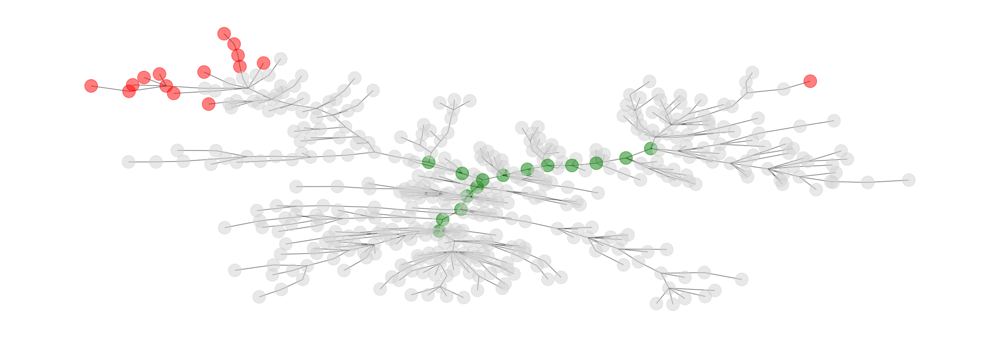

In [60]:
nodes = 15
central_portfolio = cc_measures_df.sort_values('rank_centrality').head(nodes).index
peripheral_portfolio = cc_measures_df.sort_values('rank_distance').head(nodes).index

def get_color(n):
    """Assign green if n is in central portfolio, red if in peripheral portfolio, otherwise gray"""
    if n in central_portfolio: return 'green'
    if n in peripheral_portfolio: return 'red'
    return 'lightgray'

color = [get_color(n) for n in distance_2011_till_2020_graph_filtered]
figure = plt.figure(figsize=(24, 8))
ax = plt.subplot(111)
nx.draw_kamada_kawai(distance_2011_till_2020_graph_filtered, 
                     with_labels=False, node_color=color, alpha=0.5, ax=ax)

Here, **the green stocks are the central portfolio stocks, and the red ones are the peripheral portfolio stocks.**

## **Performance Evalutation**

Here we evaluate the performance of the stocks by comparing the performance of the Central Portfolio, Peripheral and S&P 500 Stocks in 2021, and **finding out which portfolio performs the best.**

### (1) Read 2021 data

In [61]:
# collecting data for all S&P 500 components for the year 2021
yf.pdr_override() # <== that's all it takes :-)
%time price_data_2021 = web.get_data_yahoo(tickers, start='2021-01-01', end='2021-12-31')

[*********************100%***********************]  503 of 503 completed

ERROR 
2 Failed downloads:
ERROR ['GEHC']: Exception("GEHC: Data doesn't exist for startDate = 1609477200, endDate = 1640926800")
ERROR ['CEG']: Exception("CEG: Data doesn't exist for startDate = 1609477200, endDate = 1640926800")



CPU times: total: 8.31 s
Wall time: 27.4 s


In [62]:
price_data_2021 = price_data_2021['Adj Close']
# price_data_2021.to_csv('snp500_price_data_2021.csv')
price_data_2021.head()

,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACGL,ACN,ADBE,...,WYNN,XEL,XOM,XRAY,XYL,YUM,ZBH,ZBRA,ZION,ZTS
Date,,,,,,,,,,,,,,,,,,,,,
2021-01-04 00:00:00,117.039719,15.13,147.685074,127.503654,95.027641,93.312088,104.676430,34.900002,247.927536,485.339996,...,106.657669,61.637764,36.996006,52.413242,96.855469,101.172737,146.239624,378.130005,39.725563,160.784653
2021-01-05 00:00:00,117.996643,15.43,147.525497,129.080078,96.010277,94.530449,105.971573,35.040001,249.338974,485.690002,...,109.940208,61.036964,38.778946,53.914944,96.738892,101.182281,148.769913,380.570007,40.354801,161.905106
2021-01-06 00:00:00,121.232391,15.52,156.048325,124.735023,95.180885,102.662621,105.750916,36.580002,252.065140,466.309998,...,110.598709,62.388744,39.768475,56.518528,100.819450,101.736809,153.009293,394.820007,44.889053,164.283585
2021-01-07 00:00:00,124.458282,15.38,157.381195,128.991409,96.199585,106.491814,106.777435,36.240002,254.443268,477.739990,...,109.501205,61.168392,40.080490,56.225998,105.395554,100.962379,152.102203,409.100006,46.258579,164.136169
2021-01-08 00:00:00,125.346138,15.13,159.624557,130.104736,96.704414,106.395103,107.074837,36.439999,255.371338,485.100006,...,108.782837,61.731632,40.526234,56.733063,104.326820,102.444313,151.768051,405.470001,45.083378,165.227142


In [63]:
#Reading data for 2021 S&P 500 stocks:
price_data_2021 = pd.read_csv('data/snp500_price_data_2021.csv', index_col=[0])

In [64]:
# Data includes one record from 2020, this needs to be removed
price_data_2021.head()

,MMM,AOS,ABT,ABBV,ABMD,ACN,ATVI,ADM,ADBE,ADP,...,WYNN,XEL,XLNX,XYL,YUM,ZBRA,ZBH,ZION,ZTS,CEG
Date,,,,,,,,,,,,,,,,,,,,,
2020-12-31,169.412521,53.700413,107.444366,101.195663,324.200012,257.353546,92.402596,49.218819,500.119995,172.915405,...,112.830002,64.846153,141.770004,100.827858,106.770256,384.329987,153.096832,42.901466,164.329178,NaN
2021-01-04,166.582382,52.818787,107.071472,99.552361,316.730011,252.673630,89.466812,48.691574,485.339996,165.810379,...,106.900002,63.863796,142.429993,98.747719,104.075439,378.130005,152.172821,42.397789,162.432663,NaN
2021-01-05,166.301315,53.161644,108.396248,100.581787,322.600006,254.112091,90.253006,49.638653,485.690002,165.349136,...,110.190002,63.241299,144.229996,98.628838,104.085266,380.570007,154.805740,43.069359,163.564590,NaN
2021-01-06,168.831009,54.993446,108.170555,99.712914,321.609985,256.890442,87.575966,51.649975,466.309998,164.770126,...,110.849998,64.641907,141.220001,102.789139,104.655716,394.820007,159.217133,47.908611,165.967484,NaN
2021-01-07,164.498520,55.669361,109.220566,100.780106,323.559998,259.314148,89.237915,51.191086,477.739990,165.702438,...,109.750000,63.377476,149.710007,107.454628,103.859055,409.100006,158.273254,49.370266,165.818558,NaN


### **sp500 value in 2021**

In [65]:
snp_500_2021 = webreader.DataReader(['sp500'], 'fred', start='2021-01-01', end='2021-12-31')

In [66]:
snp_500_2021.head()

,sp500
DATE,
2021-01-01,NaN
2021-01-04,3700.65
2021-01-05,3726.86
2021-01-06,3748.14
2021-01-07,3803.79


In [67]:
snp_500_2021.sum()

sp500    1076898.47
dtype: float64

### (2) Removing null values

In [68]:
# Removing NA values:
price_data_2021 = price_data_2021.dropna(axis=1)
snp_500_2021 = snp_500_2021.dropna()

In [69]:
# Removing data from 2020
price_data_2021 = price_data_2021['2021-01-04':]

### (3) Getting total value of the central portfolio in 2021 per day

In [70]:
amount = 100000 # Invest ammount

# Getting total value of the central portfolio in 2021 per day
central_portfolio_value_2021 = price_data_2021[central_portfolio]
central_portfolio_value_2021.head(1)

,PRU,AMP,LNC,AME,GL,PH,EMR,TFC,USB,PNC,JPM,PFG,BRK-B,HST,ADP
Date,,,,,,,,,,,,,,,
2021-01-04,72.892754,184.909103,47.193348,117.663155,91.45298,262.594421,76.348419,45.711437,44.725113,144.454437,122.054932,47.405834,228.449997,14.15,165.810379


In [71]:
portfolio_unit = central_portfolio_value_2021.sum(axis=1)[0]
share = amount / portfolio_unit
print(f"""
Portfolio unit: {portfolio_unit}
Share: {share}
""")

central_portfolio_value_2021.sum(axis=1)


Portfolio unit: 1665.8163089752197
Share: 60.030628504002465



Date
2021-01-04    1665.816309
2021-01-05    1672.914996
2021-01-06    1736.606815
2021-01-07    1752.178043
2021-01-08    1751.223262
                 ...     
2021-12-27    2237.060863
2021-12-28    2240.447113
2021-12-29    2246.245731
2021-12-30    2234.070507
2021-12-31    2236.236500
Length: 252, dtype: float64

In [72]:
central_portfolio_value_2021 = central_portfolio_value_2021.sum(axis=1) * share
central_portfolio_value_2021

Date
2021-01-04    100000.000000
2021-01-05    100426.138652
2021-01-06    104249.598589
2021-01-07    105184.349194
2021-01-08    105127.033059
                  ...      
2021-12-27    134292.169637
2021-12-28    134495.448326
2021-12-29    134843.543028
2021-12-30    134112.656660
2021-12-31    134242.682566
Length: 252, dtype: float64

### (4) Getting total value of the peripheral portfolio in 2021 per day

In [73]:
amount = 100000 # Invest ammount

# Getting total value of the central portfolio in 2021 per day
peripheral_portfolio_value_2021 = price_data_2021[peripheral_portfolio]
peripheral_portfolio_value_2021.head(1)

,CHD,CAG,CLX,KMB,K,SJM,HRL,CPB,MNST,MO,WBA,ATO,HSY,GIS,CL
Date,,,,,,,,,,,,,,,
2021-01-04,85.587929,34.474949,194.290695,128.942917,59.208248,112.235085,45.089233,46.604916,90.599998,38.01194,39.877056,91.560829,147.900757,56.64566,82.000938


In [74]:
portfolio_unit = peripheral_portfolio_value_2021.sum(axis=1)[0]
share = amount / portfolio_unit
print(f"""
Portfolio unit: {portfolio_unit}
Share: {share}
""")

peripheral_portfolio_value_2021.sum(axis=1)


Portfolio unit: 1253.031150817871
Share: 79.80647562890084



Date
2021-01-04    1253.031151
2021-01-05    1252.416500
2021-01-06    1250.518482
2021-01-07    1243.370556
2021-01-08    1244.553585
                 ...     
2021-12-27    1365.003525
2021-12-28    1373.040665
2021-12-29    1379.072113
2021-12-30    1379.157810
2021-12-31    1389.961658
Length: 252, dtype: float64

In [75]:
peripheral_portfolio_value_2021 = peripheral_portfolio_value_2021.sum(axis=1) * share
peripheral_portfolio_value_2021

Date
2021-01-04    100000.000000
2021-01-05     99950.946892
2021-01-06     99799.472774
2021-01-07     99229.021965
2021-01-08     99323.435354
                  ...      
2021-12-27    108936.120534
2021-12-28    109577.536343
2021-12-29    110058.884980
2021-12-30    110065.724169
2021-12-31    110927.941222
Length: 252, dtype: float64

### (5) Getting total value of the SP500 in 2021 per day

In [76]:
snp_500_2021.head(3)

,sp500
DATE,
2021-01-04,3700.65
2021-01-05,3726.86
2021-01-06,3748.14


In [77]:
snp_500_2021_value = snp_500_2021 * (amount / snp_500_2021.iloc[0])
snp_500_2021_value

,sp500
DATE,
2021-01-04,100000.000000
2021-01-05,100708.253955
2021-01-06,101283.288071
2021-01-07,102787.077946
2021-01-08,103351.573372
...,...
2021-12-27,129468.877089
2021-12-28,129338.089255
2021-12-29,129519.408753


### (6) Comparing central, peripheral and sp500

In [78]:
central_portfolio_value_2021.index.astype('datetime64[ns]')

DatetimeIndex(['2021-01-04', '2021-01-05', '2021-01-06', '2021-01-07',
               '2021-01-08', '2021-01-11', '2021-01-12', '2021-01-13',
               '2021-01-14', '2021-01-15',
               ...
               '2021-12-17', '2021-12-20', '2021-12-21', '2021-12-22',
               '2021-12-23', '2021-12-27', '2021-12-28', '2021-12-29',
               '2021-12-30', '2021-12-31'],
              dtype='datetime64[ns]', name='Date', length=252, freq=None)

In [79]:
snp_500_2021_value.index#.astype('Date')

DatetimeIndex(['2021-01-04', '2021-01-05', '2021-01-06', '2021-01-07',
               '2021-01-08', '2021-01-11', '2021-01-12', '2021-01-13',
               '2021-01-14', '2021-01-15',
               ...
               '2021-12-17', '2021-12-20', '2021-12-21', '2021-12-22',
               '2021-12-23', '2021-12-27', '2021-12-28', '2021-12-29',
               '2021-12-30', '2021-12-31'],
              dtype='datetime64[ns]', name='DATE', length=252, freq=None)

In [80]:
# all_portfolios_2021 = snp_500_2021_value
# all_portfolios_2021['central_portfolio'] = central_portfolio_value_2021.values
# all_portfolios_2021['peripheral_portfolio'] = peripheral_portfolio_value_2021.values

# Converting the index to datetime64[ns]
central_portfolio_value_2021.index = central_portfolio_value_2021.index.astype('datetime64[ns]')
peripheral_portfolio_value_2021.index=peripheral_portfolio_value_2021.index.astype('datetime64[ns]')

# Concatening all datasets
all_portfolios_2021 = pd.concat([
    snp_500_2021_value,
    central_portfolio_value_2021.to_frame(name='central_portfolio'),
    peripheral_portfolio_value_2021.to_frame(name='peripheral_portfolio')
], axis=1)
# all_portfolios_2021.columns = ['snp500', 'central_portfolio', 'peripheral_portfolio']
all_portfolios_2021

,sp500,central_portfolio,peripheral_portfolio
2021-01-04,100000.000000,100000.000000,100000.000000
2021-01-05,100708.253955,100426.138652,99950.946892
2021-01-06,101283.288071,104249.598589,99799.472774
2021-01-07,102787.077946,105184.349194,99229.021965
2021-01-08,103351.573372,105127.033059,99323.435354
...,...,...,...
2021-12-27,129468.877089,134292.169637,108936.120534
2021-12-28,129338.089255,134495.448326,109577.536343
2021-12-29,129519.408753,134843.543028,110058.884980
2021-12-30,129132.179482,134112.656660,110065.724169


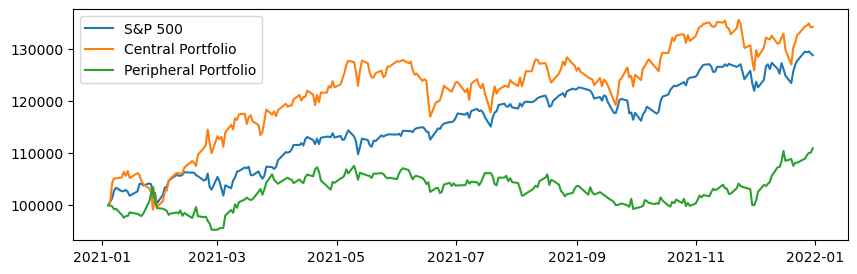

In [81]:
figure, ax = plt.subplots(figsize=(10, 3))

ax.plot(all_portfolios_2021.sp500, label='S&P 500')
ax.plot(all_portfolios_2021.central_portfolio, label= 'Central Portfolio')
ax.plot(all_portfolios_2021.peripheral_portfolio, label= 'Peripheral Portfolio')
ax.legend(loc='upper left')
plt.show()

As seen from the above plot, it is clear that **the Central Portfolio stocks perform better and the Peripheral Portfolio stocks perform poorer in comparison to the S&P 500 stocks in 2021.**

   Both the portfolios have their own features under different market conditions.
   
   Generally, **in stable market conditions Central Portfolio Stocks will perform better whereas Peripheral Portfolio Stocks will perform better in crisis market conditions**. This is due to peripheral portfolio stocks are kind of having a weak correlation so they will not be impacted by all other stocks that were present in our network.
   
   We can rebalance our stocks portfolio by using the network analysis.